# Explainability Analysis using GRAD-CAM

In [1]:
# Importing libraries
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize

import nibabel as nib
from scipy.ndimage import rotate
from scipy.ndimage import zoom
import random
import cv2

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import grad as AG

In [2]:
# Keeping all file names in the list.
NC_MRI_path = r"C:\Users\anikd\Desktop\NC_vs_PAE\Resized_MRI\NC_Resized_122_MRI"
PAE_MRI_path = r"C:\Users\anikd\Desktop\NC_vs_PAE\Resized_MRI\PAE_Resized_MRI"

NC = []
PAE = []

for file_name in os.listdir(NC_MRI_path):
    NC.append(NC_MRI_path + "/" + file_name)
    
for file_name in os.listdir(PAE_MRI_path):
    PAE.append(PAE_MRI_path + "/" + file_name)
    
print(len(NC), len(PAE))

122 122


In [3]:
NC_MRI = []
PAE_MRI = []

ref_NC_MRI = []
ref_PAE_MRI = []

for i in range(0, len(NC), +1):
    mri = nib.load(NC[i])
    data = mri.get_fdata()
    
    # Adding an extra dimension at the begining. From (160,192,160) to (1,160,192,160).
    data = data[np.newaxis, ...]
    ref_NC_MRI.append(data)
    
    data = data[np.newaxis, ...]
    data = torch.tensor(data).float()
    NC_MRI.append(data)    
    
for i in range(0, len(PAE), +1):
    mri = nib.load(PAE[i])
    data = mri.get_fdata()
    
    # Adding an extra dimension at the begining. From (160,192,160) to (1,160,192,160).
    data = data[np.newaxis, ...]
    ref_PAE_MRI.append(data)
    
    data = data[np.newaxis, ...]
    data = torch.tensor(data).float()
    PAE_MRI.append(data)

ref_NC_MRI = np.array(ref_NC_MRI)
ref_PAE_MRI = np.array(ref_PAE_MRI)

# Simple Fully Convolutional Network (SFCN) Architecture

In [4]:
class SFCN(nn.Module):
    def __init__(self, channel_number):  # channel_number = [28, 58, 128, 256, 256, 64]
        super(SFCN, self).__init__()
        
        n_layer = len(channel_number)
        
        self.feature_extractor = nn.Sequential()
        
        for i in range(n_layer):
            if i == 0:
                in_channel = 1
            else:
                in_channel = channel_number[i-1]
                
            out_channel = channel_number[i]
            
            if i < n_layer-1:
                self.feature_extractor.add_module('conv_%d' % i, self.conv_layer(in_channel, out_channel, maxpool = True, kernel_size = 3, padding = 1))
            else:
                self.feature_extractor.add_module('conv_%d' % i, self.conv_layer(in_channel, out_channel, maxpool = False, kernel_size = 1, padding = 0))
    
    
    @staticmethod
    def conv_layer(in_channel, out_channel, maxpool = True, kernel_size = 3, padding = 0, maxpool_stride = 2):
        if maxpool is True:
            layer = nn.Sequential(
                nn.Conv3d(in_channel, out_channel, padding = padding, kernel_size = kernel_size),
                nn.BatchNorm3d(out_channel),
                nn.MaxPool3d(2, stride=maxpool_stride),
                nn.ReLU(),
            )
        else:
            layer = nn.Sequential(
                nn.Conv3d(in_channel, out_channel, padding = padding, kernel_size = kernel_size),
                nn.BatchNorm3d(out_channel),
                nn.ReLU()
            )
        return layer
    

    def forward(self, input_image):
        extracted_features = self.feature_extractor(input_image) 
        
        return extracted_features   #shape: [64,5,6,5]
    

channel_number = [28, 58, 128, 256, 256, 64] # Sex-prediction
#channel_number = [32, 64, 128, 256, 256, 64] # Brain-Age-prediction

model = SFCN(channel_number)

# Loading pre-trained model - Removing weights and biases of Classification layers (Only keeping the feature extraction part)

In [5]:
tm = "BSP_run_20191008_00_epoch_last.p" # Pre-trained model aka weights and biases of already trained model for sex prediction.
#tm = "BAP_run_20190719_00_epoch_best_mae.p" # This is for Brain Age prediction.
state_dict = torch.load(tm)

# Removing weight and bias (parameters) of classifier layer.
state_dict.pop('module.classifier.conv_6.weight', None)
state_dict.pop('module.classifier.conv_6.bias', None)

# Loading after removing the classificaiton part
model.load_state_dict(state_dict, strict = False)
model

SFCN(
  (feature_extractor): Sequential(
    (conv_0): Sequential(
      (0): Conv3d(1, 28, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
      (1): BatchNorm3d(28, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): MaxPool3d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): ReLU()
    )
    (conv_1): Sequential(
      (0): Conv3d(28, 58, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
      (1): BatchNorm3d(58, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): MaxPool3d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): ReLU()
    )
    (conv_2): Sequential(
      (0): Conv3d(58, 128, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
      (1): BatchNorm3d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): MaxPool3d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): ReLU()
    )
    (conv_3): Seque

# Freezing Feature Extraction Layers of Pre-trained SFCN Model

In [6]:
for param in model.parameters():
    param.requires_grad = False

# GRAD-CAM -- Explainability for NC data

Grad-CAM normally uses the gradients of the final prediction (classification output) with respect to the feature maps. But in this case, I used the gradients of maximum activations in the feature maps instead. This modified approach helps to determine what features (brain regions) were extracted by feature extraction layers and what information is passed to the classifier. By analyzing these, we get insights into the spatial regions that are considered important in the classification stage.

Heatmap Shape:  (1, 5, 6, 5)


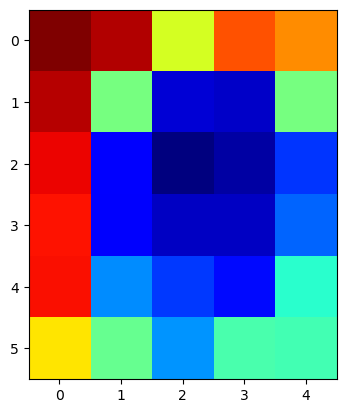

Heatmap Shape:  (1, 5, 6, 5)


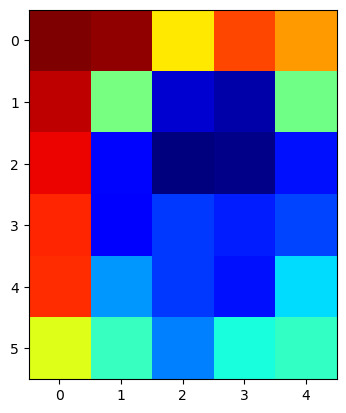

Heatmap Shape:  (1, 5, 6, 5)


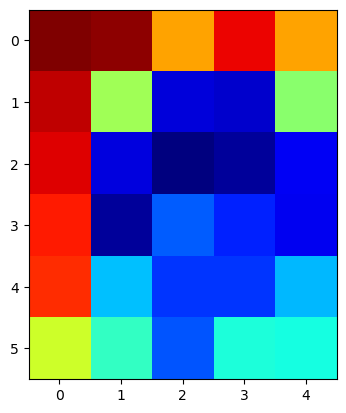

Heatmap Shape:  (1, 5, 6, 5)


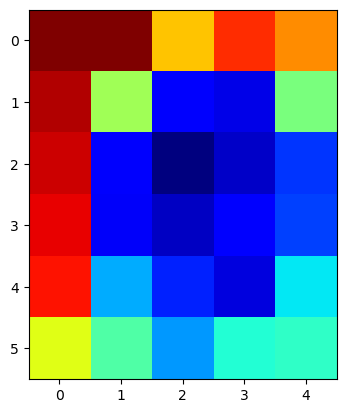

Heatmap Shape:  (1, 5, 6, 5)


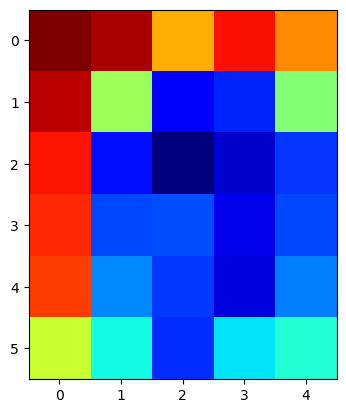

Heatmap Shape:  (1, 5, 6, 5)


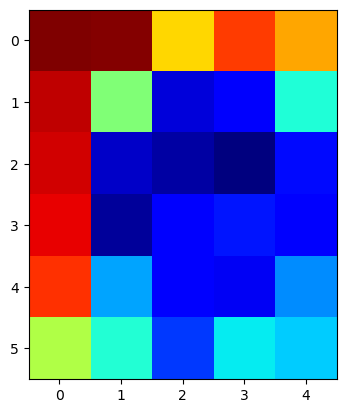

Heatmap Shape:  (1, 5, 6, 5)


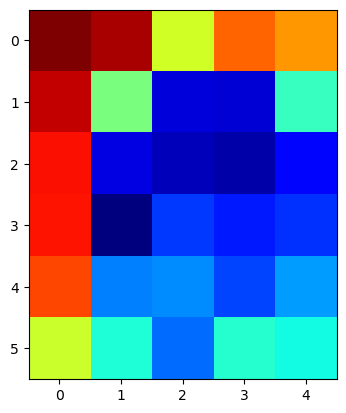

Heatmap Shape:  (1, 5, 6, 5)


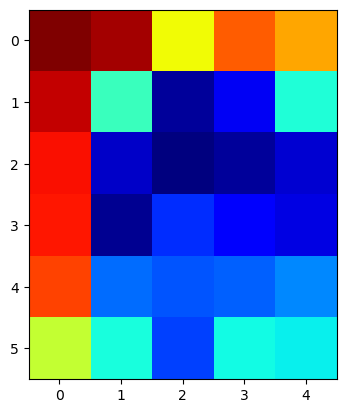

Heatmap Shape:  (1, 5, 6, 5)


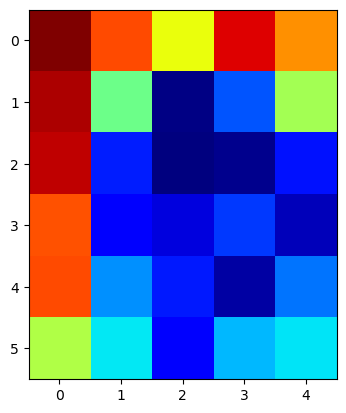

Heatmap Shape:  (1, 5, 6, 5)


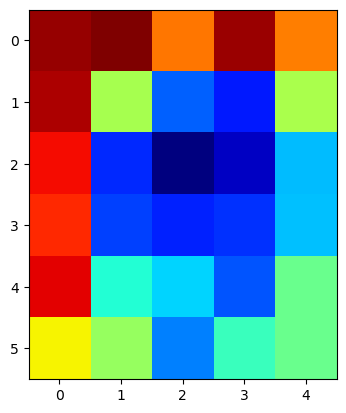

Heatmap Shape:  (1, 5, 6, 5)


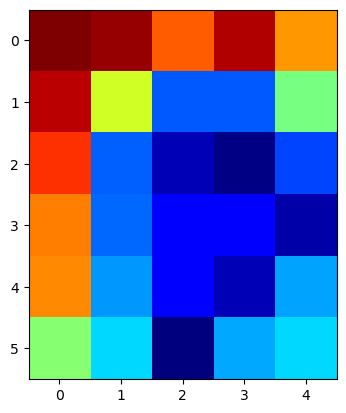

Heatmap Shape:  (1, 5, 6, 5)


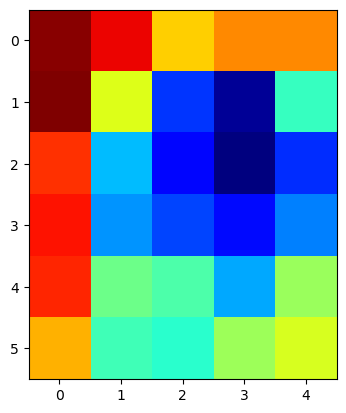

Heatmap Shape:  (1, 5, 6, 5)


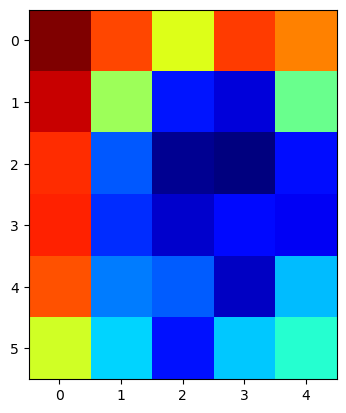

Heatmap Shape:  (1, 5, 6, 5)


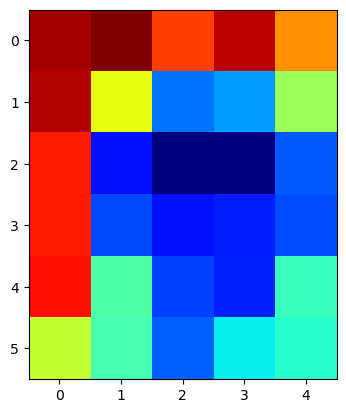

Heatmap Shape:  (1, 5, 6, 5)


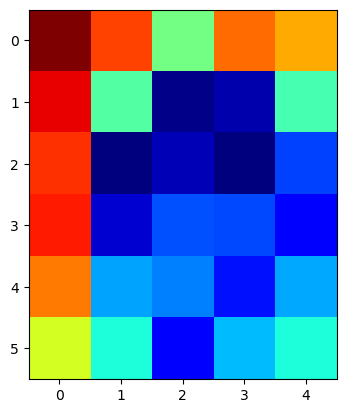

Heatmap Shape:  (1, 5, 6, 5)


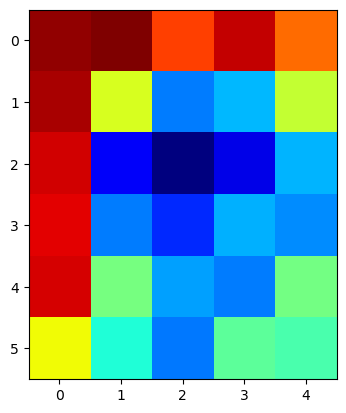

Heatmap Shape:  (1, 5, 6, 5)


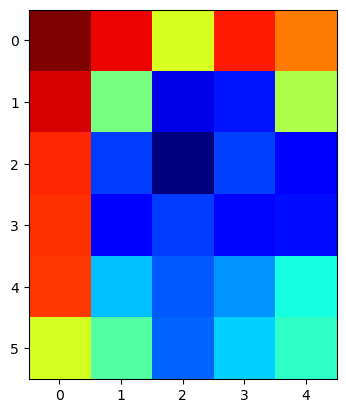

Heatmap Shape:  (1, 5, 6, 5)


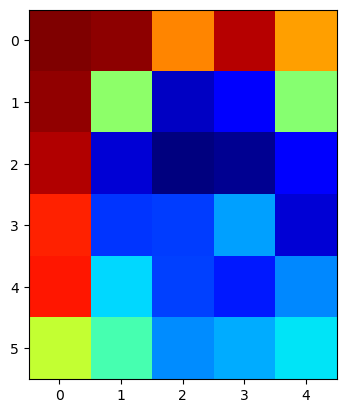

Heatmap Shape:  (1, 5, 6, 5)


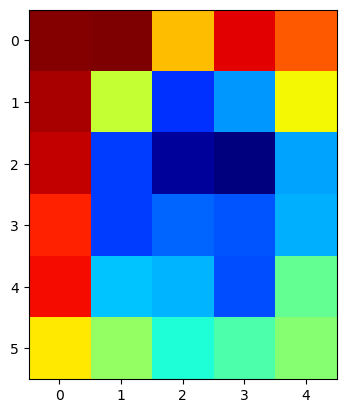

Heatmap Shape:  (1, 5, 6, 5)


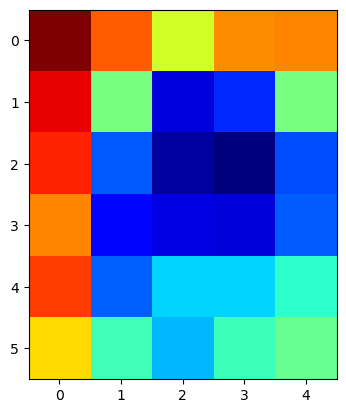

Heatmap Shape:  (1, 5, 6, 5)


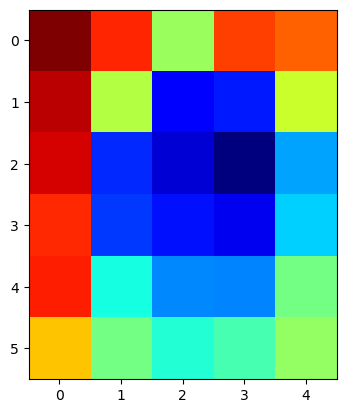

Heatmap Shape:  (1, 5, 6, 5)


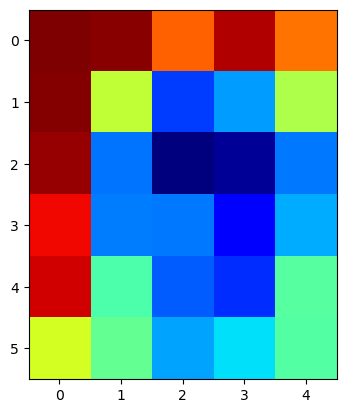

Heatmap Shape:  (1, 5, 6, 5)


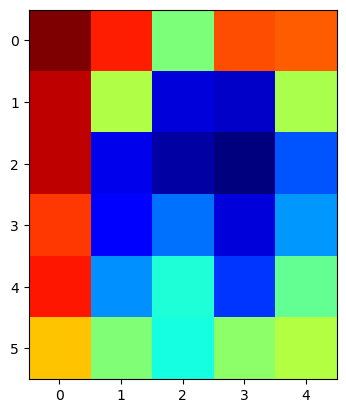

Heatmap Shape:  (1, 5, 6, 5)


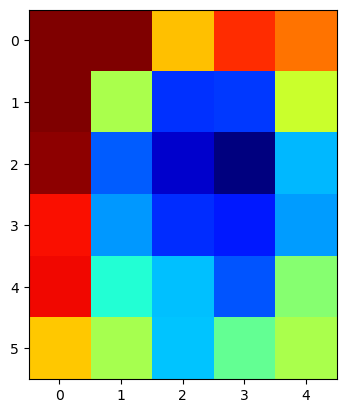

Heatmap Shape:  (1, 5, 6, 5)


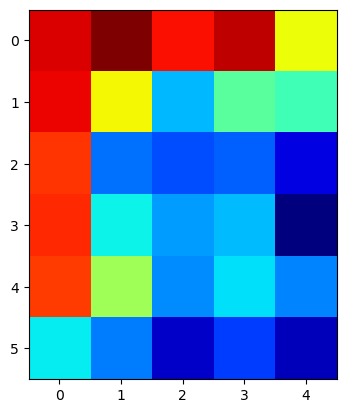

Heatmap Shape:  (1, 5, 6, 5)


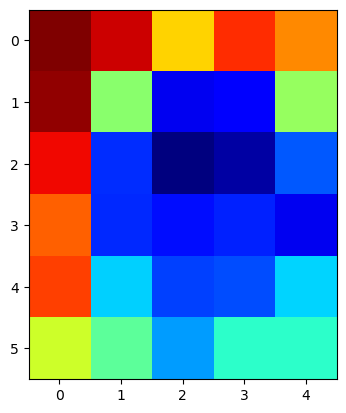

Heatmap Shape:  (1, 5, 6, 5)


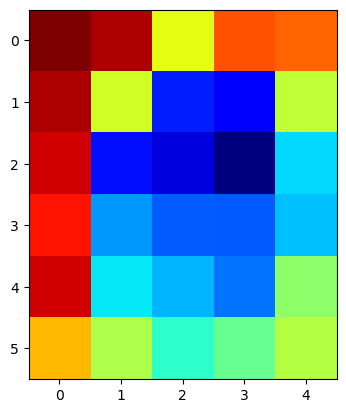

Heatmap Shape:  (1, 5, 6, 5)


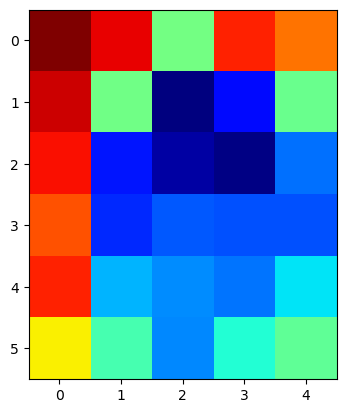

Heatmap Shape:  (1, 5, 6, 5)


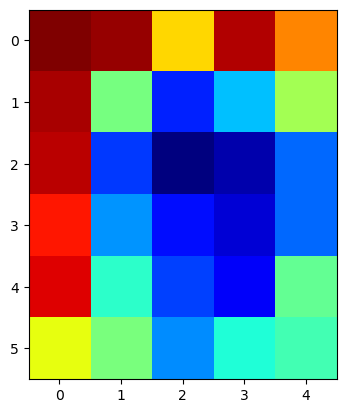

Heatmap Shape:  (1, 5, 6, 5)


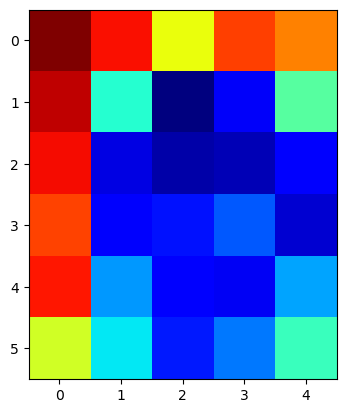

Heatmap Shape:  (1, 5, 6, 5)


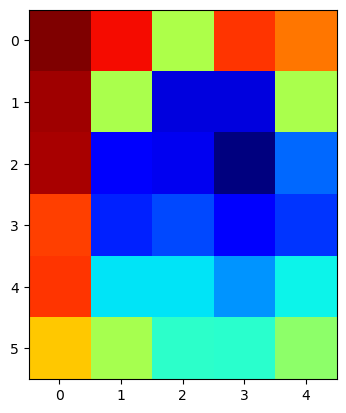

Heatmap Shape:  (1, 5, 6, 5)


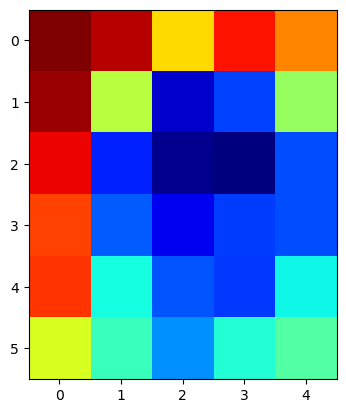

Heatmap Shape:  (1, 5, 6, 5)


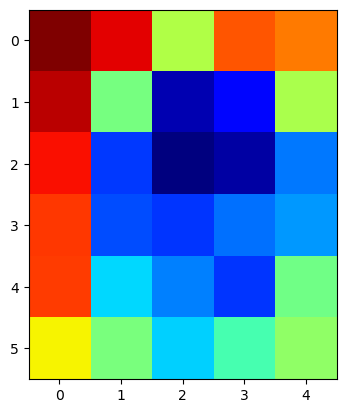

Heatmap Shape:  (1, 5, 6, 5)


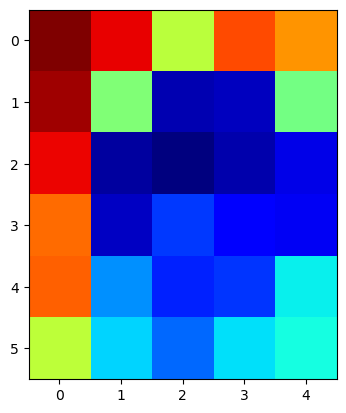

Heatmap Shape:  (1, 5, 6, 5)


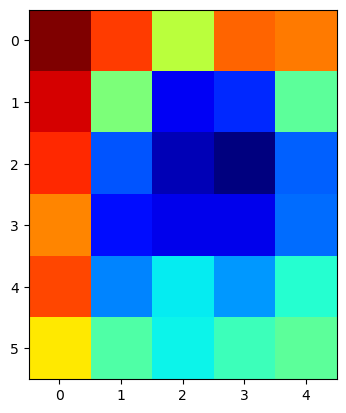

Heatmap Shape:  (1, 5, 6, 5)


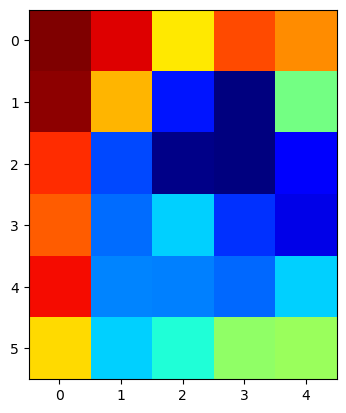

Heatmap Shape:  (1, 5, 6, 5)


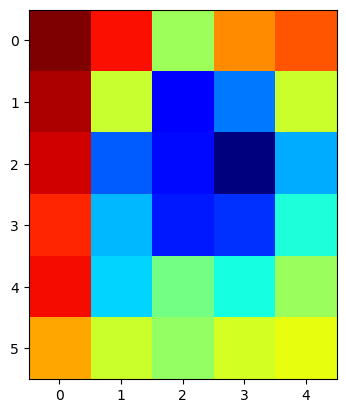

Heatmap Shape:  (1, 5, 6, 5)


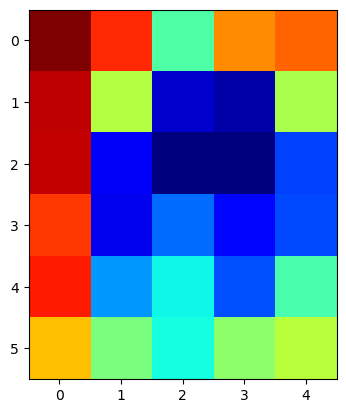

Heatmap Shape:  (1, 5, 6, 5)


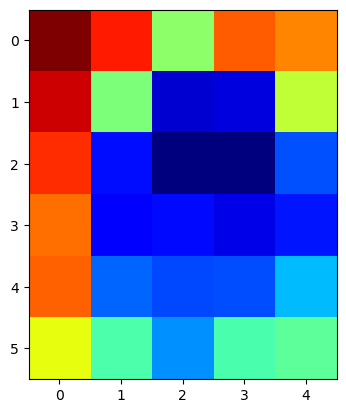

Heatmap Shape:  (1, 5, 6, 5)


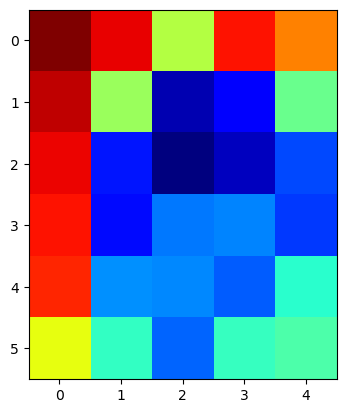

Heatmap Shape:  (1, 5, 6, 5)


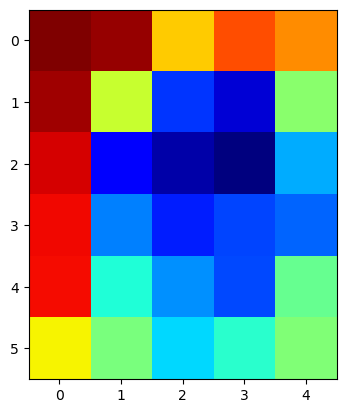

Heatmap Shape:  (1, 5, 6, 5)


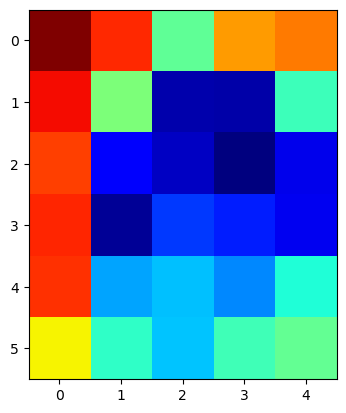

Heatmap Shape:  (1, 5, 6, 5)


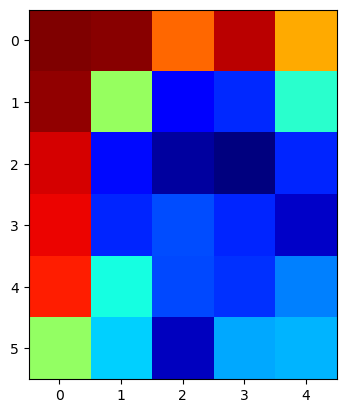

Heatmap Shape:  (1, 5, 6, 5)


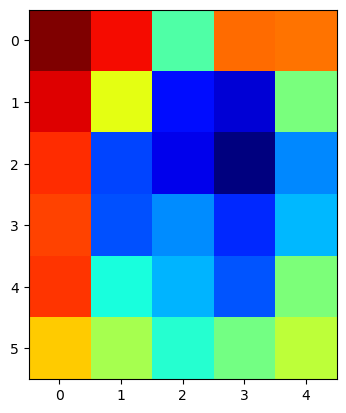

Heatmap Shape:  (1, 5, 6, 5)


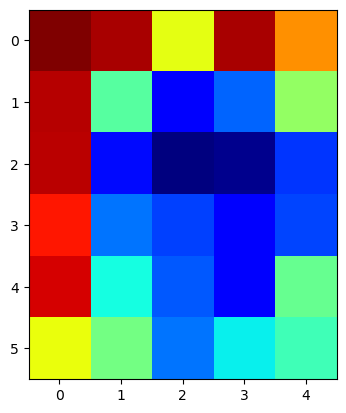

Heatmap Shape:  (1, 5, 6, 5)


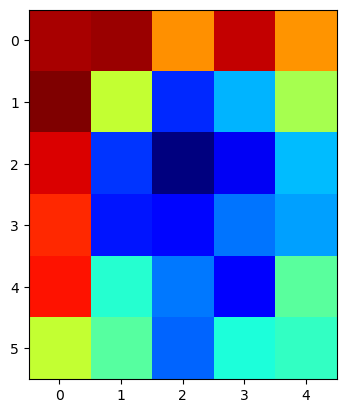

Heatmap Shape:  (1, 5, 6, 5)


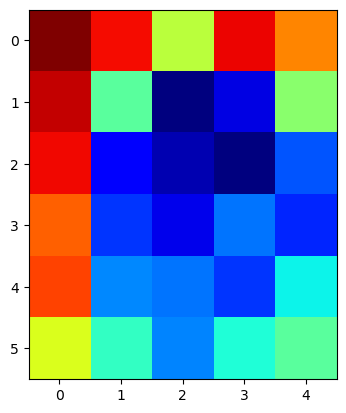

Heatmap Shape:  (1, 5, 6, 5)


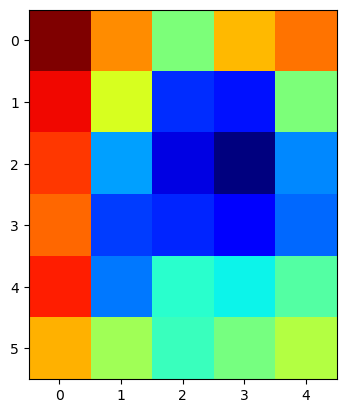

Heatmap Shape:  (1, 5, 6, 5)


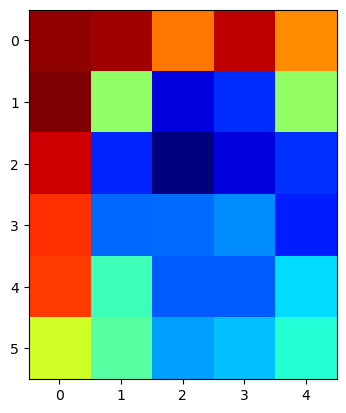

Heatmap Shape:  (1, 5, 6, 5)


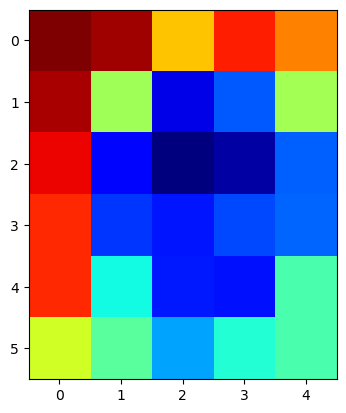

Heatmap Shape:  (1, 5, 6, 5)


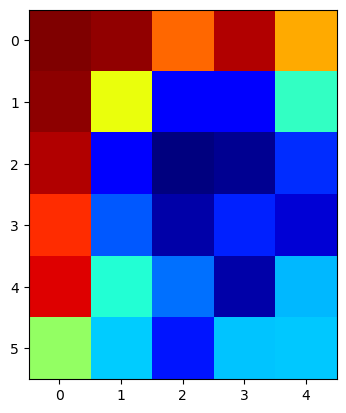

Heatmap Shape:  (1, 5, 6, 5)


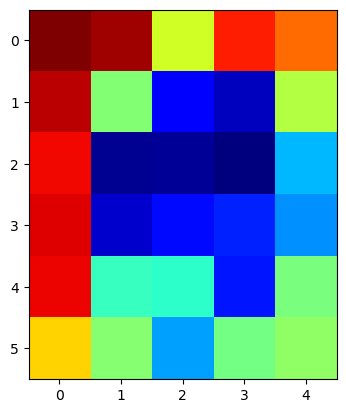

Heatmap Shape:  (1, 5, 6, 5)


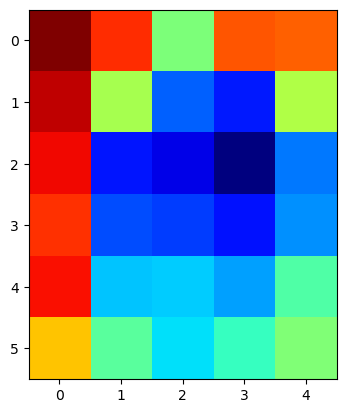

Heatmap Shape:  (1, 5, 6, 5)


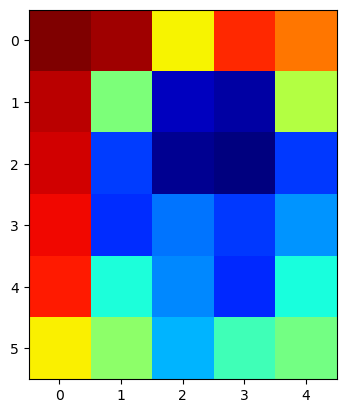

Heatmap Shape:  (1, 5, 6, 5)


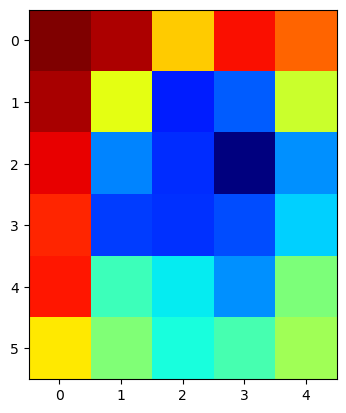

Heatmap Shape:  (1, 5, 6, 5)


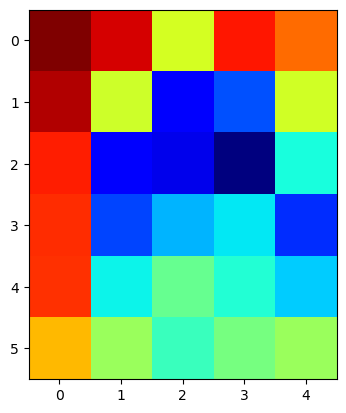

Heatmap Shape:  (1, 5, 6, 5)


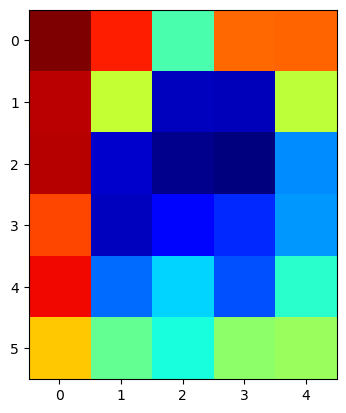

Heatmap Shape:  (1, 5, 6, 5)


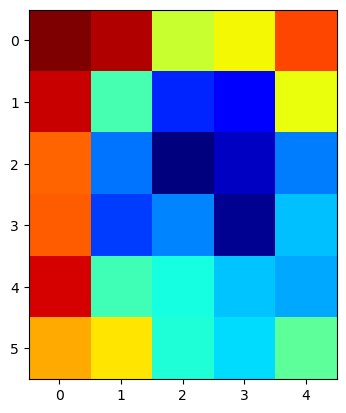

Heatmap Shape:  (1, 5, 6, 5)


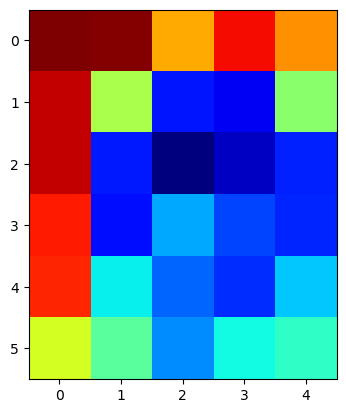

Heatmap Shape:  (1, 5, 6, 5)


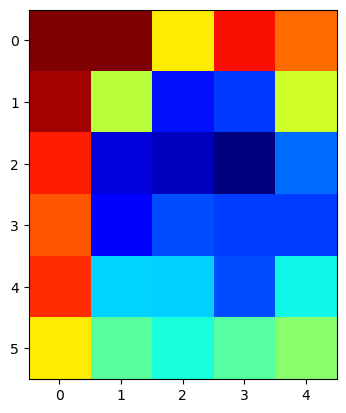

Heatmap Shape:  (1, 5, 6, 5)


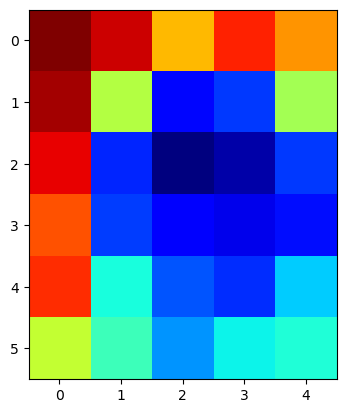

Heatmap Shape:  (1, 5, 6, 5)


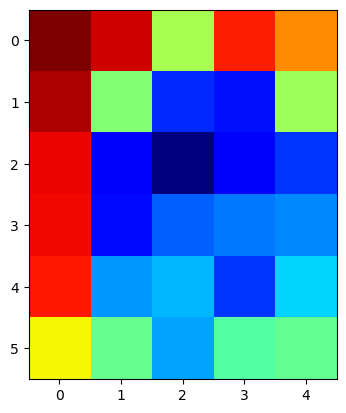

Heatmap Shape:  (1, 5, 6, 5)


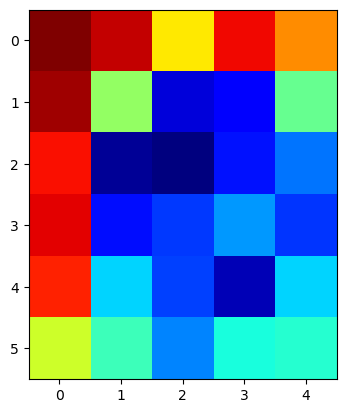

Heatmap Shape:  (1, 5, 6, 5)


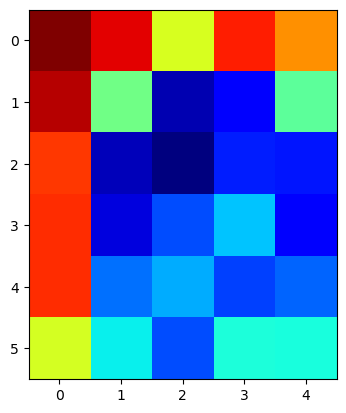

Heatmap Shape:  (1, 5, 6, 5)


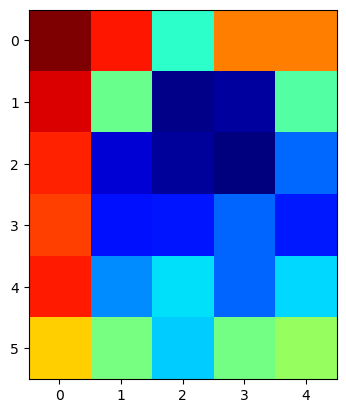

Heatmap Shape:  (1, 5, 6, 5)


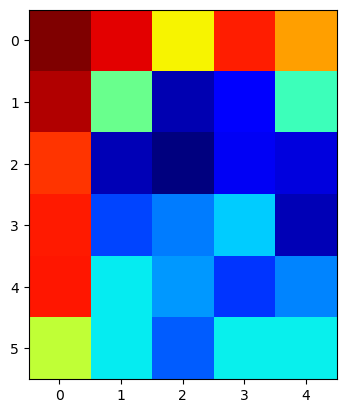

Heatmap Shape:  (1, 5, 6, 5)


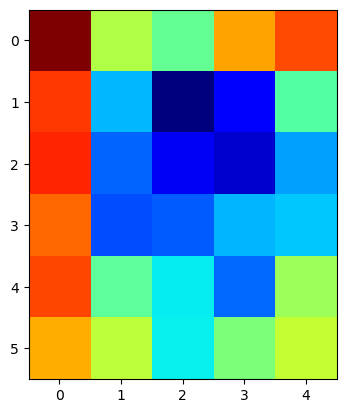

Heatmap Shape:  (1, 5, 6, 5)


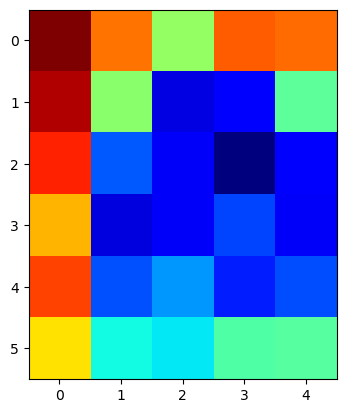

Heatmap Shape:  (1, 5, 6, 5)


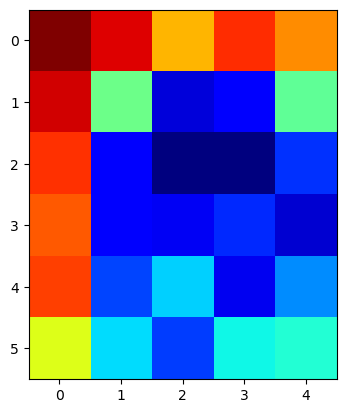

Heatmap Shape:  (1, 5, 6, 5)


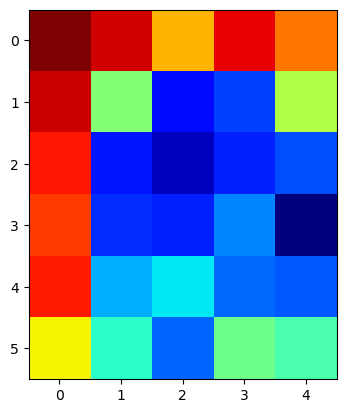

Heatmap Shape:  (1, 5, 6, 5)


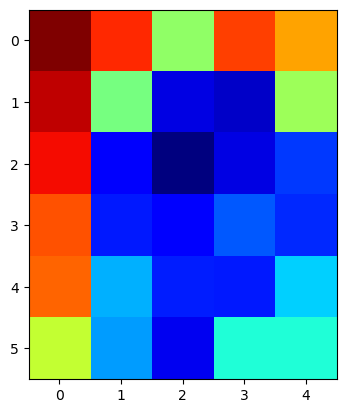

Heatmap Shape:  (1, 5, 6, 5)


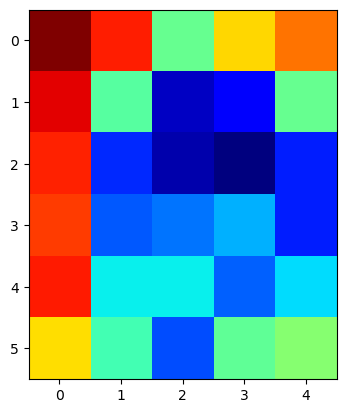

Heatmap Shape:  (1, 5, 6, 5)


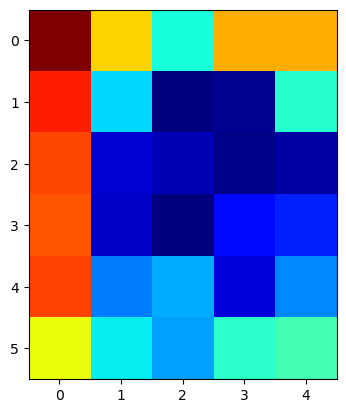

Heatmap Shape:  (1, 5, 6, 5)


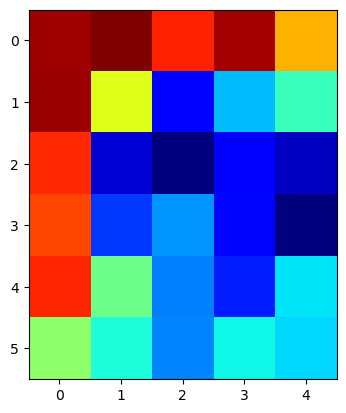

Heatmap Shape:  (1, 5, 6, 5)


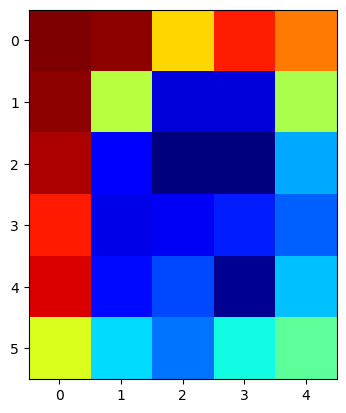

Heatmap Shape:  (1, 5, 6, 5)


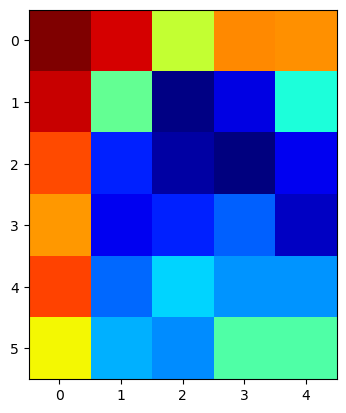

Heatmap Shape:  (1, 5, 6, 5)


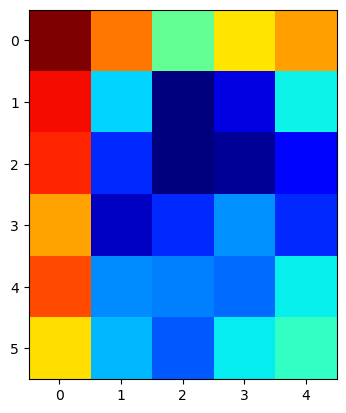

Heatmap Shape:  (1, 5, 6, 5)


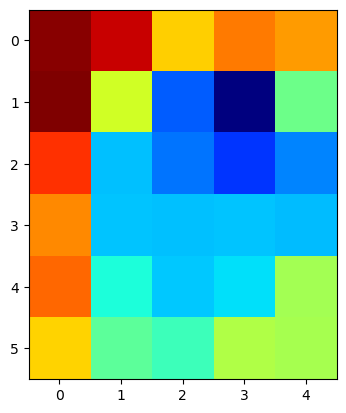

Heatmap Shape:  (1, 5, 6, 5)


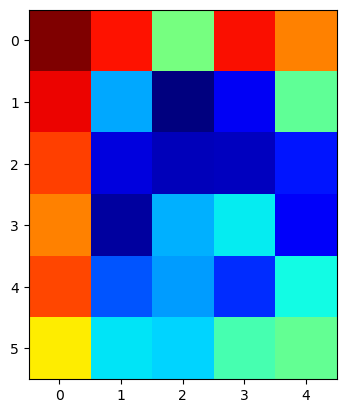

Heatmap Shape:  (1, 5, 6, 5)


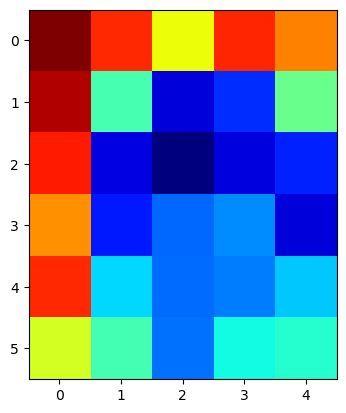

Heatmap Shape:  (1, 5, 6, 5)


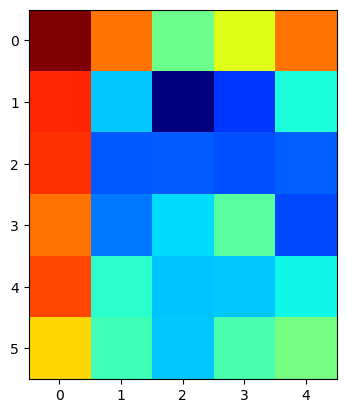

Heatmap Shape:  (1, 5, 6, 5)


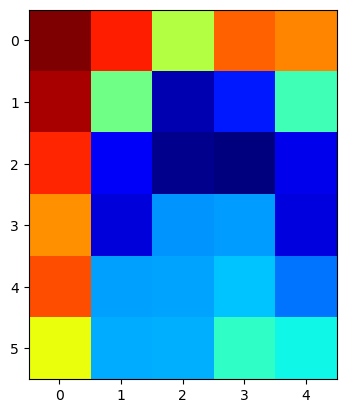

Heatmap Shape:  (1, 5, 6, 5)


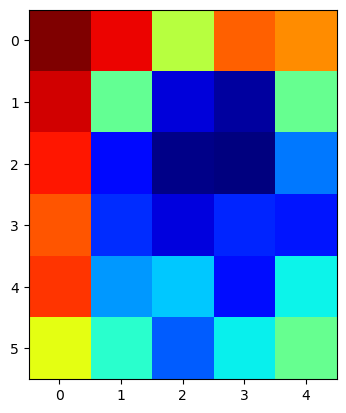

Heatmap Shape:  (1, 5, 6, 5)


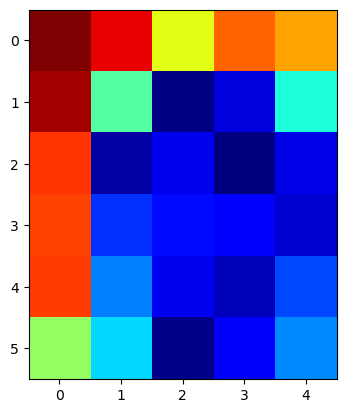

Heatmap Shape:  (1, 5, 6, 5)


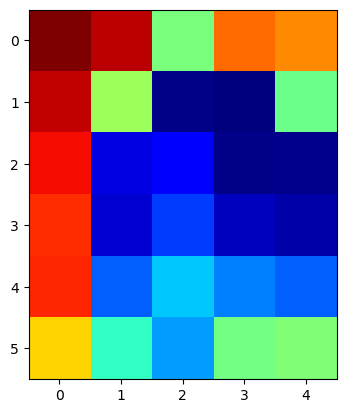

Heatmap Shape:  (1, 5, 6, 5)


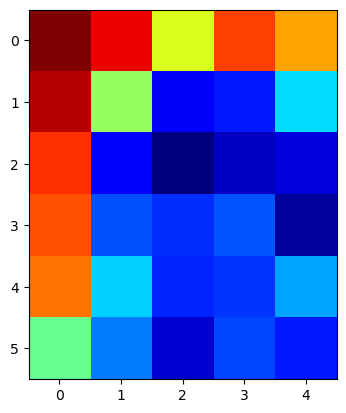

Heatmap Shape:  (1, 5, 6, 5)


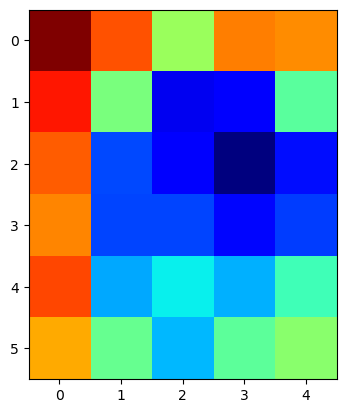

Heatmap Shape:  (1, 5, 6, 5)


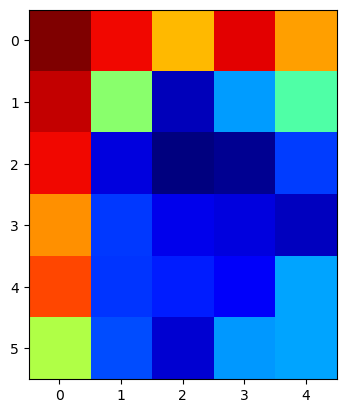

Heatmap Shape:  (1, 5, 6, 5)


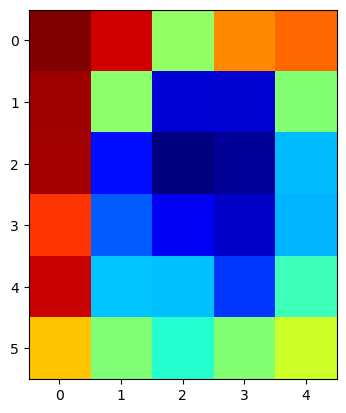

Heatmap Shape:  (1, 5, 6, 5)


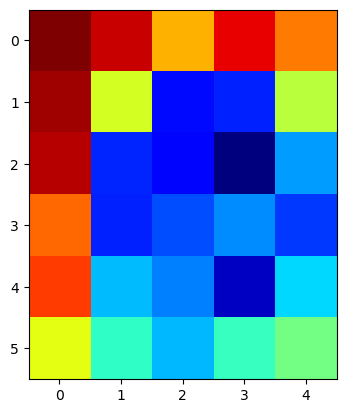

Heatmap Shape:  (1, 5, 6, 5)


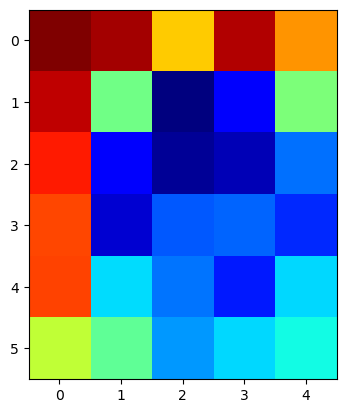

Heatmap Shape:  (1, 5, 6, 5)


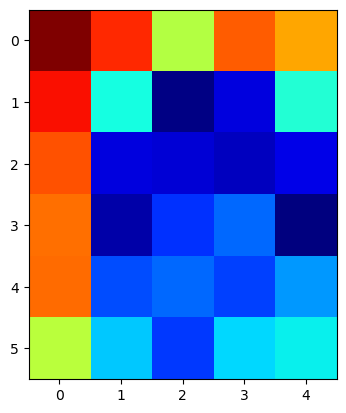

Heatmap Shape:  (1, 5, 6, 5)


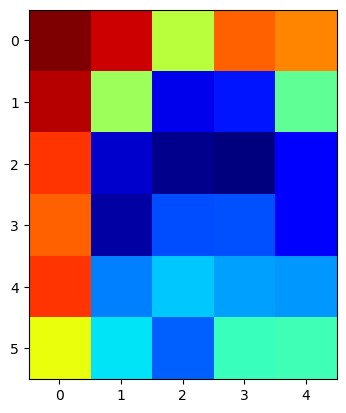

Heatmap Shape:  (1, 5, 6, 5)


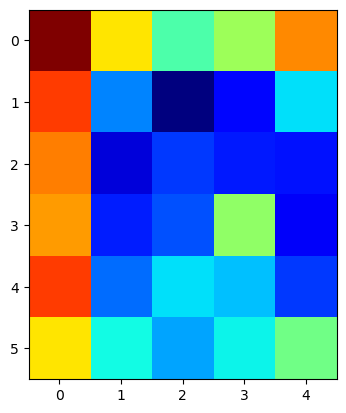

Heatmap Shape:  (1, 5, 6, 5)


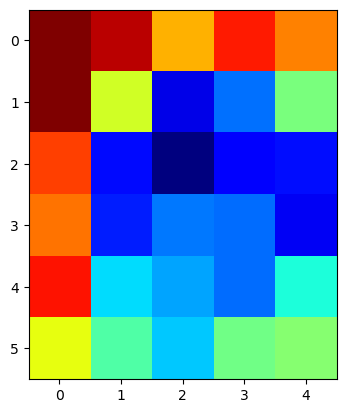

Heatmap Shape:  (1, 5, 6, 5)


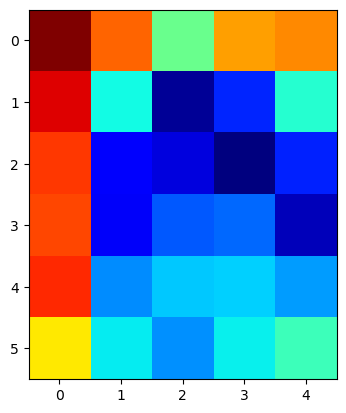

Heatmap Shape:  (1, 5, 6, 5)


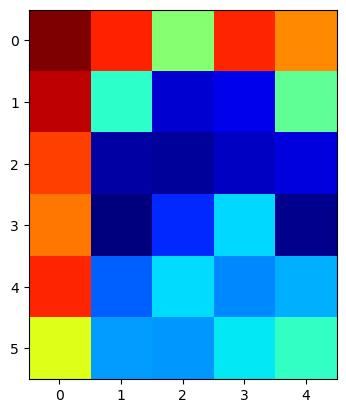

Heatmap Shape:  (1, 5, 6, 5)


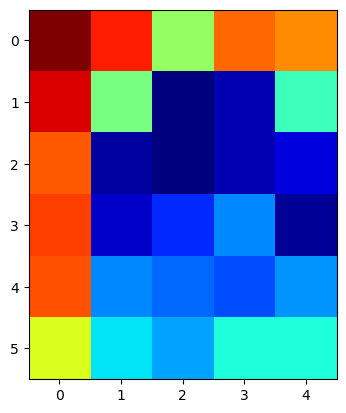

Heatmap Shape:  (1, 5, 6, 5)


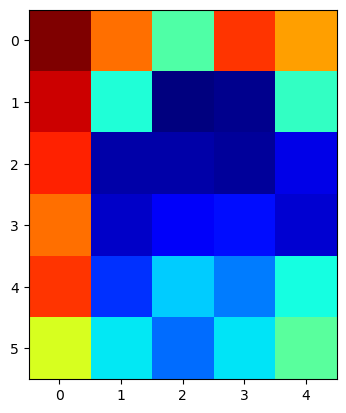

Heatmap Shape:  (1, 5, 6, 5)


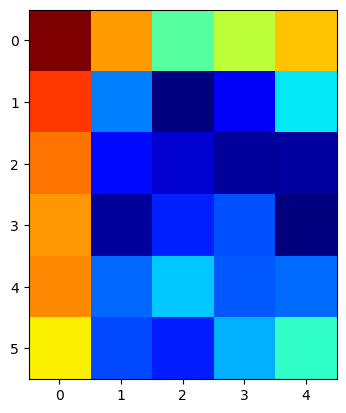

Heatmap Shape:  (1, 5, 6, 5)


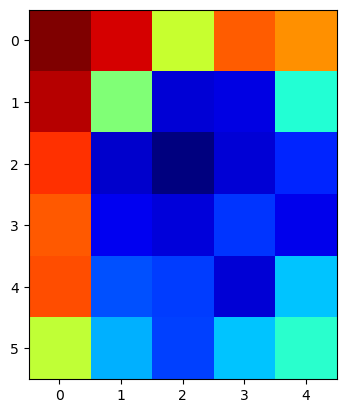

Heatmap Shape:  (1, 5, 6, 5)


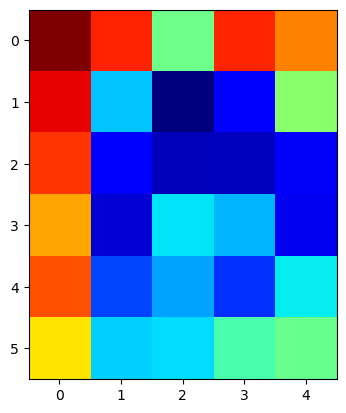

Heatmap Shape:  (1, 5, 6, 5)


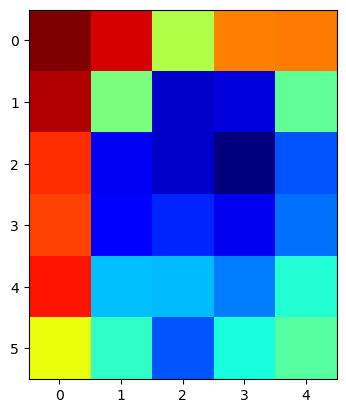

Heatmap Shape:  (1, 5, 6, 5)


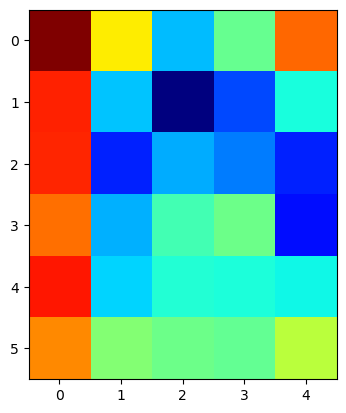

Heatmap Shape:  (1, 5, 6, 5)


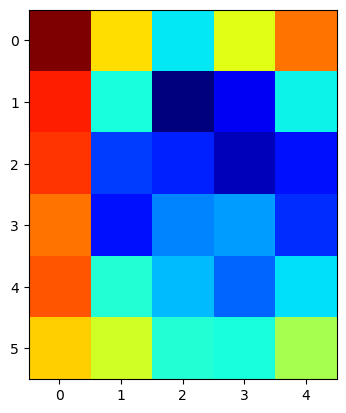

Heatmap Shape:  (1, 5, 6, 5)


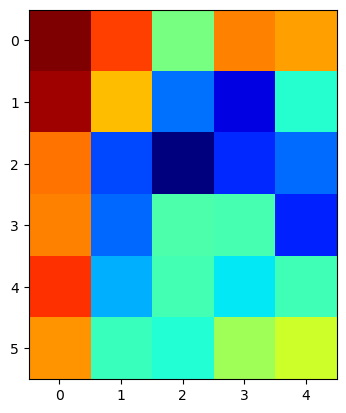

Heatmap Shape:  (1, 5, 6, 5)


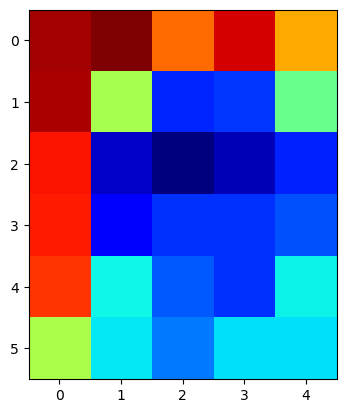

Heatmap Shape:  (1, 5, 6, 5)


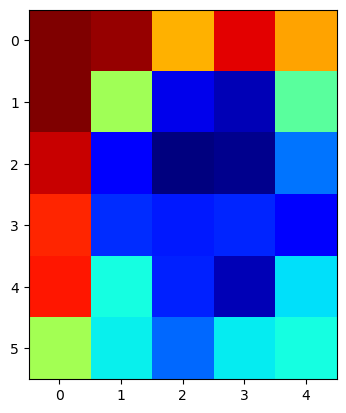

Heatmap Shape:  (1, 5, 6, 5)


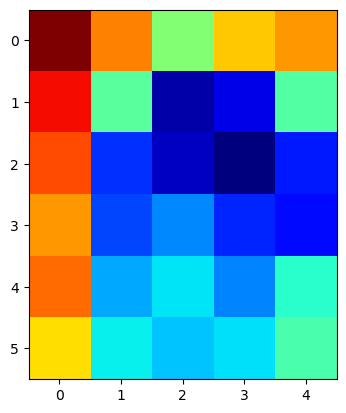

Heatmap Shape:  (1, 5, 6, 5)


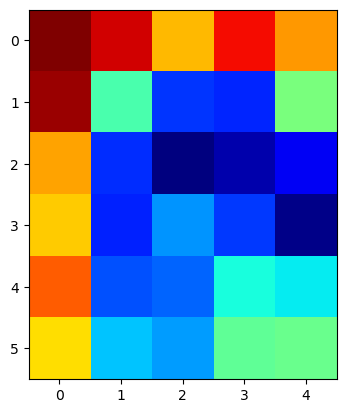

Heatmap Shape:  (1, 5, 6, 5)


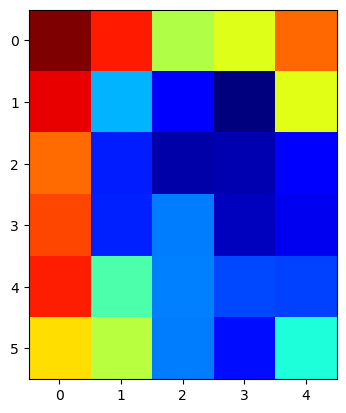

Heatmap Shape:  (1, 5, 6, 5)


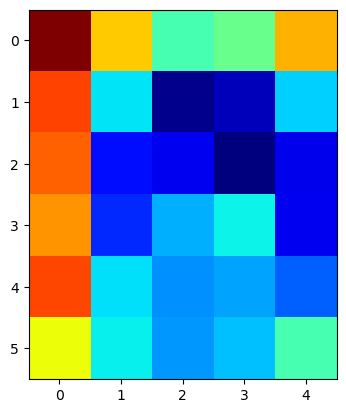

Heatmap Shape:  (1, 5, 6, 5)


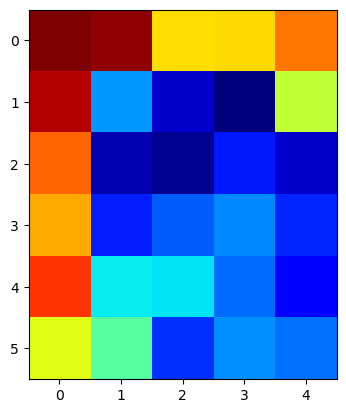

Heatmap Shape:  (1, 5, 6, 5)


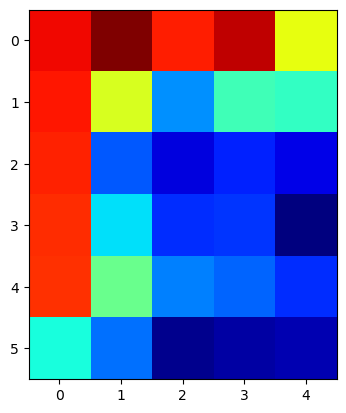

Heatmap Shape:  (1, 5, 6, 5)


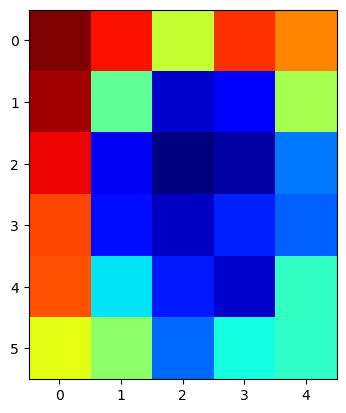

Heatmap Shape:  (1, 5, 6, 5)


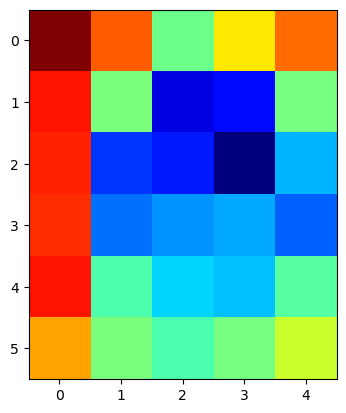

Heatmap Shape:  (1, 5, 6, 5)


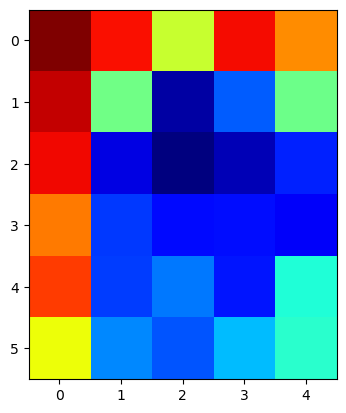

Heatmap Shape:  (1, 5, 6, 5)


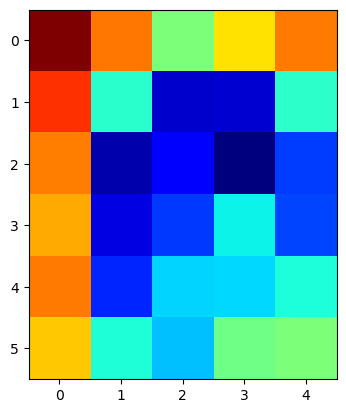

Heatmap Shape:  (1, 5, 6, 5)


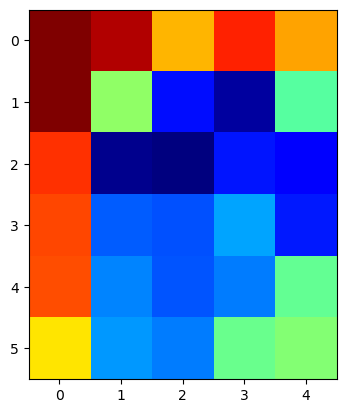

Heatmap Shape:  (1, 5, 6, 5)


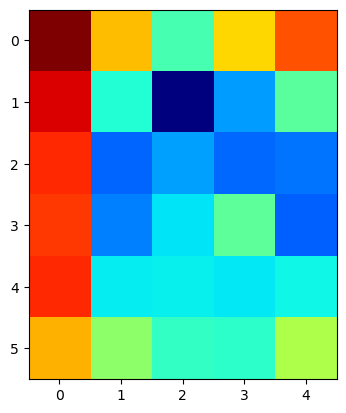

Heatmap Shape:  (1, 5, 6, 5)


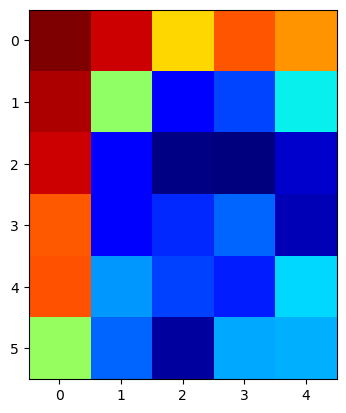

Heatmap Shape:  (1, 5, 6, 5)


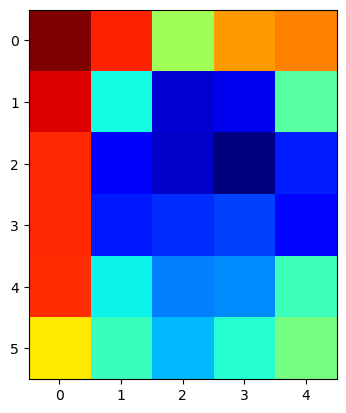

In [7]:
NC_Extracted_MRI = []

model.eval()
model.cuda()

for input_image in NC_MRI:
    input_image = input_image.cuda()

    features = model(input_image)

    # Computing the gradient of the maximum activation in each feature map
    features.requires_grad_()
    max_activations = torch.max(features.view(features.size(0), features.size(1), -1), dim=2)[0]
    grads = AG(outputs=max_activations, inputs=features, grad_outputs=torch.ones_like(max_activations), retain_graph=True, create_graph=True)[0]

    # Computing the average gradient over the spatial dimensions of each feature map
    pooled_grads = torch.mean(grads.view(grads.size(0), grads.size(1), -1), dim=2)

    # Weight each feature map by the corresponding gradient value
    weights = torch.sum(pooled_grads[:, :, None, None, None] * features, dim=1)

    # Applying ReLU activation
    heatmap = F.relu(weights)
    heatmap = heatmap / torch.max(heatmap)

    heatmap = heatmap.detach().cpu().numpy()
    NC_Extracted_MRI.append(heatmap)
    
    print("Heatmap Shape: ", heatmap.shape)
    plt.imshow(heatmap[0, 0, :, :], cmap = "jet")
    plt.show()

# Visualizing the blended image (overlaying heatmap and input image)

Feature maps retain more localized spatial details comapared to final convolutional layers (which often have much lower spatial resolution). This is the potential reason of getting high level, high resolution blenned image after overlaying heatmap and original input scan. But in the standard Grad-CAM scenario, we usally get blur, low level heatmaps.

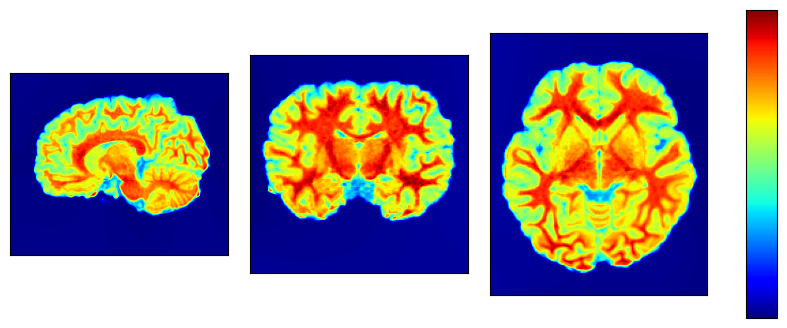

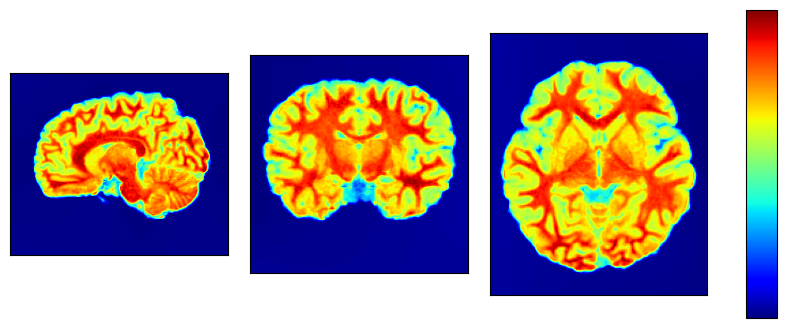

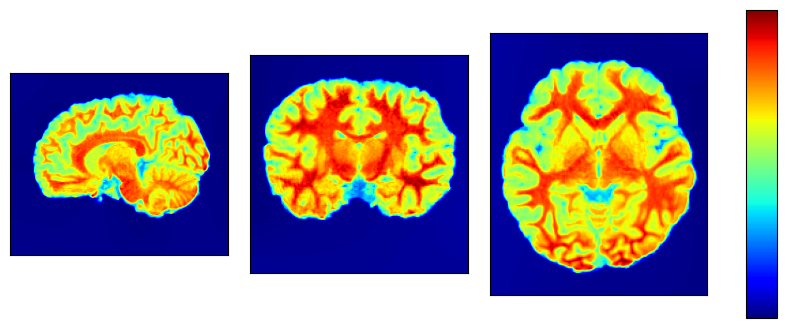

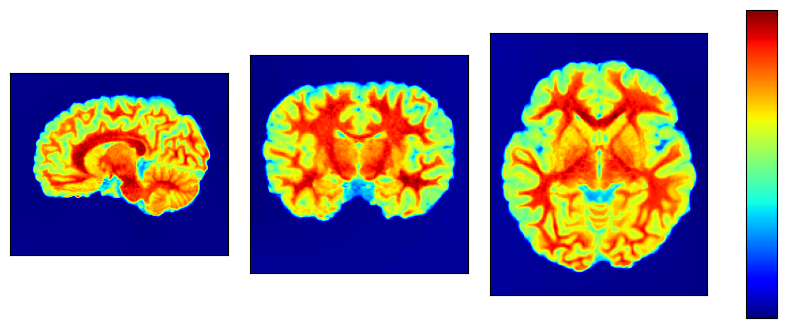

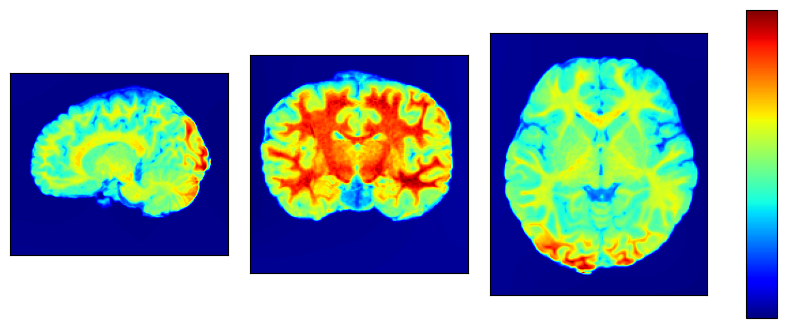

...

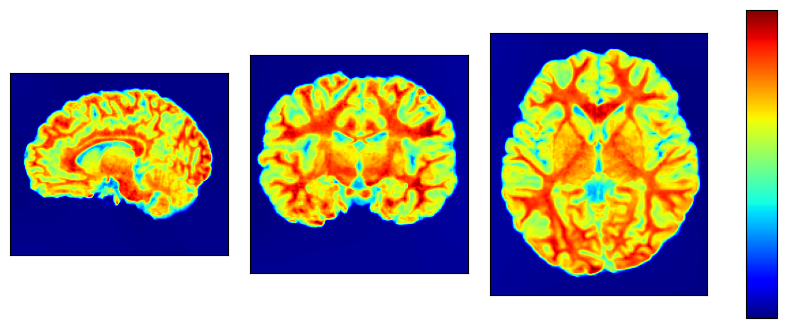

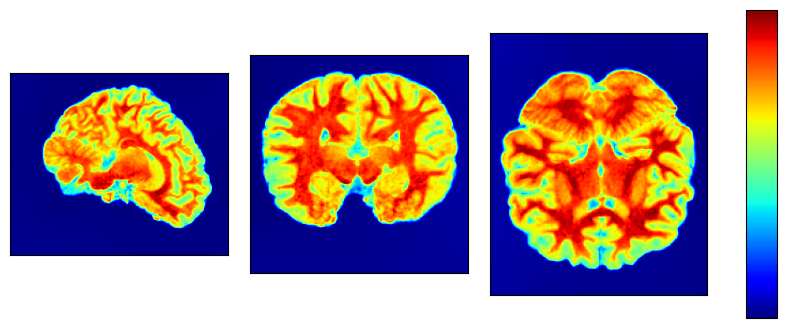

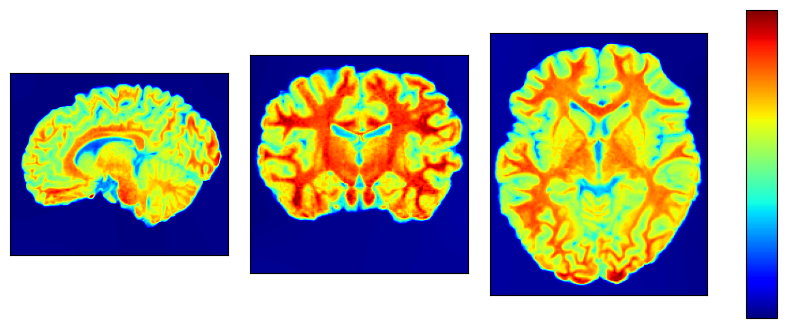

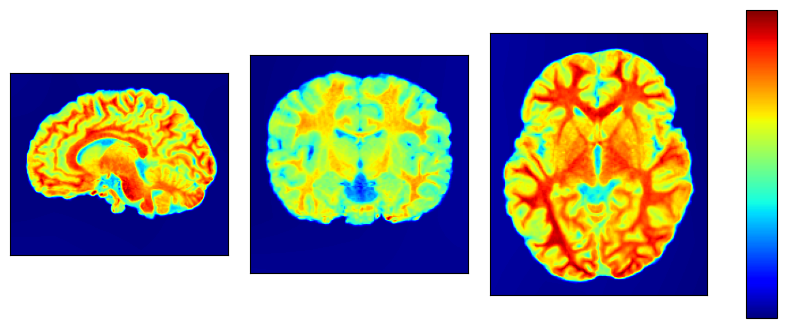

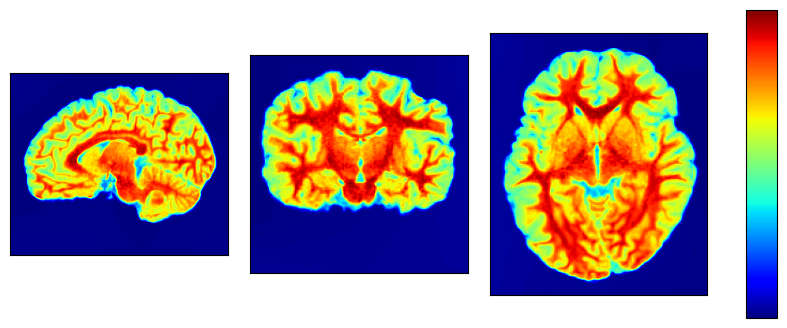

In [8]:
for a in range(0, len(NC_Extracted_MRI), +1):
    heatmap = NC_Extracted_MRI[a]
    heatmap_resized = zoom(heatmap, (1, 160 / heatmap.shape[1], 192 / heatmap.shape[2], 160 / heatmap.shape[3]), order=1)  # order=1 for trilinear

    # Ensuring both the heatmap and input scan are float32
    heatmap_resized = heatmap_resized.astype(np.float32)
    ref_image = ref_NC_MRI[a].astype(np.float32)

    # Blending the heatmap with the input scan
    blended_image = cv2.addWeighted(ref_image, 0.7, heatmap_resized, 0.3, 0)

    # Plotting the blended image
    fig, ax = plt.subplots(1, 3, figsize=(10, 10))
    fig.subplots_adjust(wspace=0.1, hspace=0.5)

    im0 = ax[0].imshow(rotate(blended_image[0, 89, :, :], 90, reshape=True), cmap="jet")
    im1 = ax[1].imshow(rotate(blended_image[0, :, 95, :], 90, reshape=True), cmap="jet")
    im2 = ax[2].imshow(rotate(blended_image[0, :, :, 79], -90, reshape=True), cmap="jet")
    
    # Plotting resized heatmap
    #im0 = ax[0].imshow(rotate(heatmap_resized[0, 79, :, :], 90, reshape=True), cmap="jet")
    #im1 = ax[1].imshow(rotate(heatmap_resized[0, :, 95, :], 90, reshape=True), cmap="jet")
    #im2 = ax[2].imshow(rotate(heatmap_resized[0, :, :, 79], -90, reshape=True), cmap="jet")
    
    # Removing axis numbers
    for axis in ax:
        axis.set_xticks([])
        axis.set_yticks([])

    # Adding color bar
    cbar = fig.colorbar(im0, ax=ax, aspect=10, shrink=0.4, fraction=0.05, ticks=[])
    cbar.ax.tick_params(size=0)
    
    plt.show()